In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import models
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
import albumentations as A
from albumentations.pytorch import ToTensorV2
import shutil
from sklearn.model_selection import train_test_split
import timm
import matplotlib.pyplot as plt
from torch.optim import AdamW
import torch.nn.functional as F

/datadisk2/bangkit/c242-fs01/project/model/project-solafune/.miniconda3/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:

class ImageMaskDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        """
        Dataset untuk memuat gambar dan masker.
        
        Args:
            image_dir (str): Path folder gambar (.npy).
            mask_dir (str): Path folder masker (.npy).
            transform (callable, optional): Transformasi data augmentasi untuk gambar dan masker.
        """
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform

        # Dapatkan semua file dengan ekstensi .npy
        self.image_files = sorted([f for f in os.listdir(image_dir) if f.endswith(".npy")])
        self.mask_files = sorted([f for f in os.listdir(mask_dir) if f.endswith(".npy")])

        # Validasi apakah jumlah file gambar dan masker sama
        assert len(self.image_files) == len(self.mask_files), "Jumlah file gambar dan masker tidak sama!"

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Path file gambar dan masker
        image_path = os.path.join(self.image_dir, self.image_files[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_files[idx])
    
        # Load data
        image = np.load(image_path)  # (H, W, C)
        mask = np.load(mask_path)   # (H, W)
    
        # Normalisasi gambar ke [0, 1] jika belum dinormalisasi
        if image.max() > 1.0:
            image = image / 255.0
    
        # Apply transformasi
        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']
            
        image = image.to(torch.float32)
        mask = mask.to(torch.long)

        return image, mask

In [5]:
def get_transforms():
    """
    Mengembalikan transformasi augmentasi untuk dataset.
    """
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5),
        A.Rotate(limit=30, p=0.5),  # Rotasi hingga 30 derajat
        ToTensorV2()
    ], additional_targets={'mask': 'mask'})


In [6]:
def split_dataset(image_dir, mask_dir, train_ratio=0.8):
    """
    Membagi dataset menjadi train dan validation set.

    Args:
        image_dir (str): Path folder gambar (.npy).
        mask_dir (str): Path folder masker (.npy).
        train_ratio (float): Rasio data untuk training.

    Returns:
        train_dataset, val_dataset: Dataset untuk training dan validation.
    """
    full_dataset = ImageMaskDataset(image_dir, mask_dir, transform=get_transforms())
    train_size = int(len(full_dataset) * train_ratio)
    val_size = len(full_dataset) - train_size
    train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])
    return train_dataset, val_dataset

In [7]:
class UNet(nn.Module):
    def __init__(self, encoder_name="resnet50", in_channels=3, num_classes=3, pretrained=True):
        super(UNet, self).__init__()
        
        # Load EfficientNet encoder from timm
        self.encoder = timm.create_model(
            encoder_name, features_only=True, in_chans=in_channels, pretrained=pretrained
        )
        
        # Extract feature map channels from encoder
        encoder_channels = [f["num_chs"] for f in self.encoder.feature_info]
        
        # Define decoder channels
        decoder_channels = [512, 256, 128, 64]
        
        # Bottleneck
        self.bottleneck = self.conv_block(encoder_channels[-1], decoder_channels[0])
        
        # Decoder
        self.upconv4 = self.upconv(decoder_channels[0], decoder_channels[1])
        self.dec4 = self.conv_block(encoder_channels[-2] + decoder_channels[1], decoder_channels[1])
        self.upconv3 = self.upconv(decoder_channels[1], decoder_channels[2])
        self.dec3 = self.conv_block(encoder_channels[-3] + decoder_channels[2], decoder_channels[2])
        self.upconv2 = self.upconv(decoder_channels[2], decoder_channels[3])
        self.dec2 = self.conv_block(encoder_channels[-4] + decoder_channels[3], decoder_channels[3])
        self.upconv1 = self.upconv(decoder_channels[3], decoder_channels[3])
        self.dec1 = self.conv_block(encoder_channels[-5] + decoder_channels[3], decoder_channels[3])
        
        # Segmentation head with upsampling
        self.seg_head = nn.Sequential(
            nn.Conv2d(decoder_channels[3], num_classes, kernel_size=1),
            nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)  # Ensure output size matches target
        )

    def conv_block(self, in_channels, out_channels):
        """Basic convolutional block with batch normalization."""
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def upconv(self, in_channels, out_channels):
        """Upsampling layer."""
        return nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)

    def forward(self, x):
        # Encoder
        enc_features = self.encoder(x)  # List of feature maps from encoder
        
        # Bottleneck
        bottleneck = self.bottleneck(enc_features[-1])
        
        # Decoder with skip connections
        dec4 = self.upconv4(bottleneck)
        dec4 = self.dec4(torch.cat([dec4, enc_features[-2]], dim=1))
        dec3 = self.upconv3(dec4)
        dec3 = self.dec3(torch.cat([dec3, enc_features[-3]], dim=1))
        dec2 = self.upconv2(dec3)
        dec2 = self.dec2(torch.cat([dec2, enc_features[-4]], dim=1))
        dec1 = self.upconv1(dec2)
        dec1 = self.dec1(torch.cat([dec1, enc_features[-5]], dim=1))
        
        # Segmentation head
        seg = self.seg_head(dec1)
        return seg

In [8]:
def dice_coefficient_multiclass(pred, target, num_classes, smooth=1e-6):
    """
    Menghitung Dice Coefficient untuk segmentasi multi-kelas.
    Args:
        pred (torch.Tensor): Prediksi model [B, C, H, W] (logits atau probabilitas).
        target (torch.Tensor): Target ground truth [B, H, W] (label integer).
        num_classes (int): Jumlah kelas dalam dataset.
        smooth (float): Faktor smoothing untuk mencegah pembagian nol.
    Returns:
        float: Nilai rata-rata Dice Coefficient untuk semua kelas.
    """
    pred = torch.softmax(pred, dim=1)  # Konversi logits ke probabilitas
    target_one_hot = F.one_hot(target, num_classes=num_classes).permute(0, 3, 1, 2)  # One-hot encoding [B, C, H, W]

    dice_per_class = []
    for c in range(num_classes):
        pred_class = pred[:, c, :, :]  # Probabilitas untuk kelas c
        target_class = target_one_hot[:, c, :, :].float()  # Target untuk kelas c
        
        intersection = (pred_class * target_class).sum()
        union = pred_class.sum() + target_class.sum()
        
        dice = (2.0 * intersection + smooth) / (union + smooth)
        dice_per_class.append(dice.item())

    # Hitung rata-rata Dice Coefficient untuk semua kelas
    return sum(dice_per_class) / num_classes


# Fungsi IoU
def iou_score(pred, target, smooth=1e-6):
    pred = torch.softmax(pred, dim=1).argmax(dim=1)  # Ambil prediksi kelas
    target = target.long()
    intersection = (pred & target).sum().float()
    union = (pred | target).sum().float()
    return ((intersection + smooth) / (union + smooth)).item()

In [9]:
class DiceCrossEntropyLoss(nn.Module):
    def __init__(self, num_classes, dice_weight=0.5, smooth=1e-6):
        """
        Kombinasi Dice Loss dan Cross-Entropy Loss.
        Args:
            num_classes (int): Jumlah kelas target.
            dice_weight (float): Bobot untuk Dice Loss dalam kombinasi.
            smooth (float): Faktor smoothing untuk Dice Loss untuk mencegah pembagian nol.
        """
        super(DiceCrossEntropyLoss, self).__init__()
        self.num_classes = num_classes
        self.dice_weight = dice_weight
        self.smooth = smooth
        self.cross_entropy = nn.CrossEntropyLoss()

    def forward(self, pred, target):
        """
        Forward pass untuk loss function.
        Args:
            pred (torch.Tensor): Prediksi dari model [B, C, H, W].
            target (torch.Tensor): Ground truth label [B, H, W].
        Returns:
            torch.Tensor: Nilai loss gabungan.
        """
        if target.dim() == 4 and target.size(1) == 1:
            target = target.squeeze(1)

        target = target.long()

        # Compute Cross-Entropy Loss
        ce_loss = self.cross_entropy(pred, target)

        # Compute Dice Loss
        dice_loss = self.dice_loss(pred, target)

        # Kombinasikan kedua loss
        combined_loss = self.dice_weight * dice_loss + (1 - self.dice_weight) * ce_loss
        return combined_loss

    def dice_loss(self, pred, target):
        """
        Hitung Dice Loss untuk segmentasi multi-kelas.
        Args:
            pred (torch.Tensor): Prediksi dari model [B, C, H, W].
            target (torch.Tensor): Ground truth label [B, H, W].
        Returns:
            torch.Tensor: Nilai Dice Loss.
        """
        # Apply softmax to predictions
        pred_softmax = F.softmax(pred, dim=1)  # Convert logits to probabilities

        # One-hot encode target
        target_one_hot = F.one_hot(target, num_classes=self.num_classes).permute(0, 3, 1, 2).float()

        # Flatten pred and target for Dice computation
        pred_flat = pred_softmax.contiguous().view(pred.size(0), pred.size(1), -1)
        target_flat = target_one_hot.contiguous().view(target_one_hot.size(0), target_one_hot.size(1), -1)

        # Compute intersection and union
        intersection = (pred_flat * target_flat).sum(-1)
        union = pred_flat.sum(-1) + target_flat.sum(-1)

        # Dice coefficient
        dice_coeff = (2.0 * intersection + self.smooth) / (union + self.smooth)

        # Dice loss is 1 - mean Dice coefficient
        dice_loss = 1 - dice_coeff.mean()
        return dice_loss

In [10]:
def train_model(image_dir, mask_dir, device="cuda:7", checkpoint_path="best_model_2.pth"):
    train_dataset, val_dataset = split_dataset(image_dir, mask_dir, train_ratio=0.8)

    train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False, num_workers=2)

    model = UNet(encoder_name="resnet50", in_channels=3, num_classes=3, pretrained=True).to(device)
    loss_fn = DiceCrossEntropyLoss(num_classes=3, dice_weight=0.7)
    optimizer = AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

    best_val_loss = float("inf")

    for epoch in range(1, 101):
        # Training Phase
        model.train()
        train_loss = 0
        for images, masks in train_loader:
            images, masks = images.to(device), masks.to(device).long()  # Convert target to long
            outputs = model(images)
            loss = loss_fn(outputs, masks)
            train_loss += loss.item()
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        train_loss /= len(train_loader)

        # Validation Phase
        model.eval()
        val_loss = 0
        iou, dice = 0, 0
        with torch.no_grad():
            for images, masks in val_loader:
                images, masks = images.to(device), masks.to(device).long()
                outputs = model(images)
                loss = loss_fn(outputs, masks)
                val_loss += loss.item()
                iou += iou_score(outputs, masks)
                dice += dice_coefficient_multiclass(outputs, masks, num_classes=3)
    
        val_loss /= len(val_loader)
        iou /= len(val_loader)
        dice /= len(val_loader)

        scheduler.step(val_loss)
        
        print(f"Epoch {epoch}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, IoU: {iou:.4f}, Dice: {dice:.4f}")

        # Simpan model jika val_loss lebih rendah
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), checkpoint_path)
            print(f"Model disimpan di {checkpoint_path} dengan Val Loss: {best_val_loss:.4f}")

    print("Training selesai!")

In [11]:
# image_dir = "data_3/train/images_npy"
# mask_dir = "data_3/train/masks_npy/"

# # Jalankan Training
# train_model(image_dir, mask_dir)

/datadisk2/bangkit/c242-fs01/project/model/project-solafune/.miniconda3/lib/python3.12/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 1, Train Loss: 0.7893, Val Loss: 0.8639, IoU: 0.0276, Dice: 0.2786
Model disimpan di best_model_2.pth dengan Val Loss: 0.8639
Epoch 2, Train Loss: 0.6996, Val Loss: 0.6397, IoU: 0.5879, Dice: 0.4122
Model disimpan di best_model_2.pth dengan Val Loss: 0.6397
Epoch 3, Train Loss: 0.6625, Val Loss: 0.5760, IoU: 0.5762, Dice: 0.4776
Model disimpan di best_model_2.pth dengan Val Loss: 0.5760
Epoch 4, Train Loss: 0.6451, Val Loss: 0.5690, IoU: 0.5888, Dice: 0.4822
Model disimpan di best_model_2.pth dengan Val Loss: 0.5690
Epoch 5, Train Loss: 0.6216, Val Loss: 0.5753, IoU: 0.5571, Dice: 0.4871
Epoch 6, Train Loss: 0.5997, Val Loss: 0.5476, IoU: 0.5958, Dice: 0.5044
Model disimpan di best_model_2.pth dengan Val Loss: 0.5476
Epoch 7, Train Loss: 0.5858, Val Loss: 0.5521, IoU: 0.5659, Dice: 0.5073
Epoch 8, Train Loss: 0.5853, Val Loss: 0.5255, IoU: 0.6035, Dice: 0.5266
Model disimpan di best_model_2.pth dengan Val Loss: 0.5255
Epoch 9, Train Loss: 0.5705, Val Loss: 0.5600, IoU: 0.5426, Di

In [11]:
import os
import torch
import numpy as np
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

# Dataset untuk folder test (dengan file .npy)
class TestDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.image_files = os.listdir(image_dir)
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Mengambil path file .npy
        image_path = os.path.join(self.image_dir, self.image_files[idx])
        
        # Memuat gambar yang disimpan dalam format .npy
        image = np.load(image_path, allow_pickle=True)  # Memuat file .npy
        
        # Jika ada transformasi, terapkan transformasi tersebut
        if self.transform:
            image = self.transform(image)
        
        # Pastikan gambar memiliki format yang benar (C, H, W)
        image = torch.tensor(image, dtype=torch.float32)  # Konversi ke tensor
        return image, self.image_files[idx]

# Transformasi untuk gambar
transform = transforms.Compose([
    transforms.ToTensor()  # Sesuaikan dengan encoder
])

# Folder test
test_image_dir = "data_3/test/images_npy/"
test_dataset = TestDataset(image_dir=test_image_dir, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)


/tmp/ipykernel_2026463/2326393930.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_test.load_state_dict(torch.load("best_model_2.pth"))
/tmp/ipykernel_2026463/20729

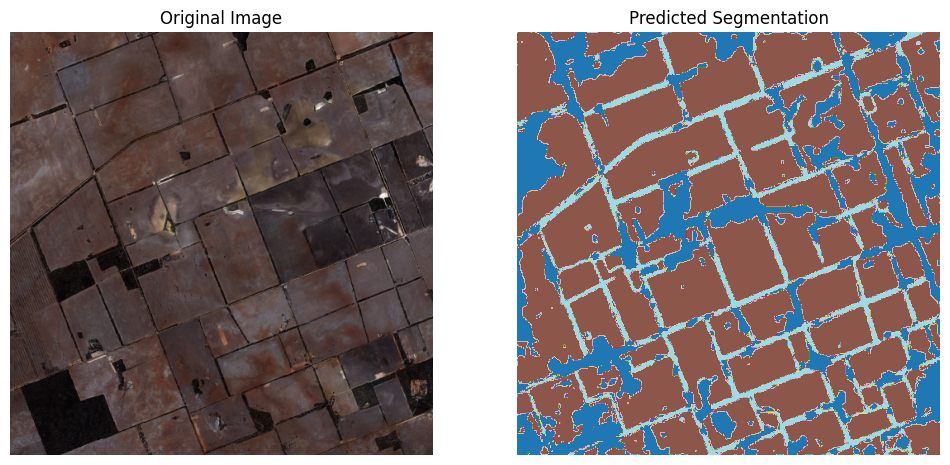

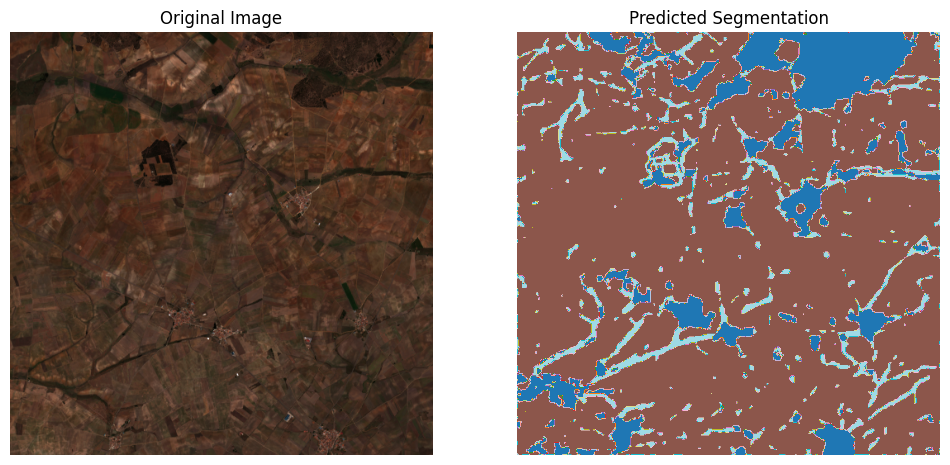

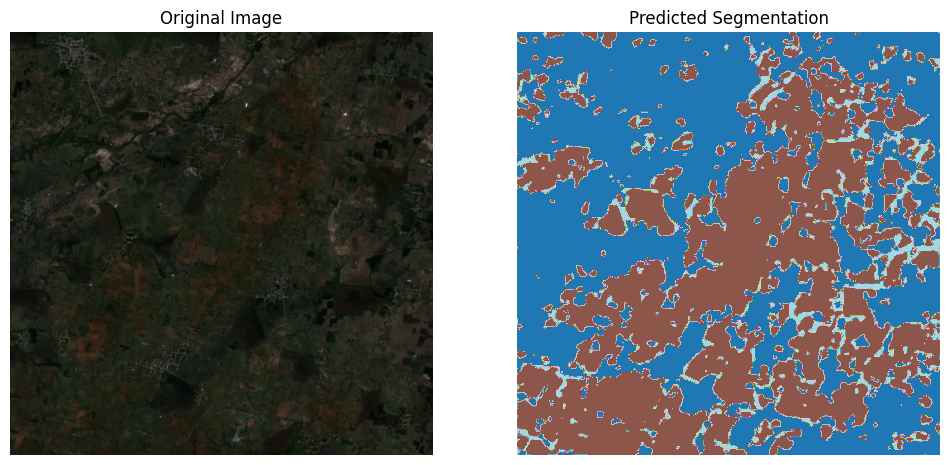

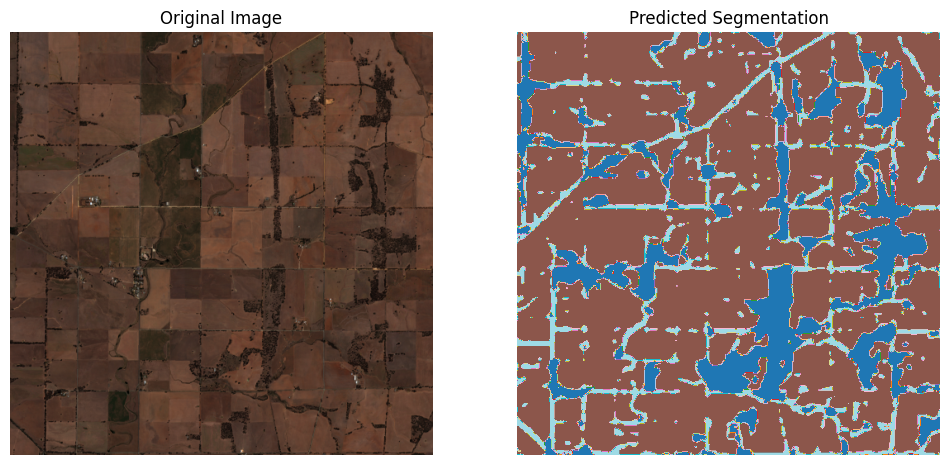

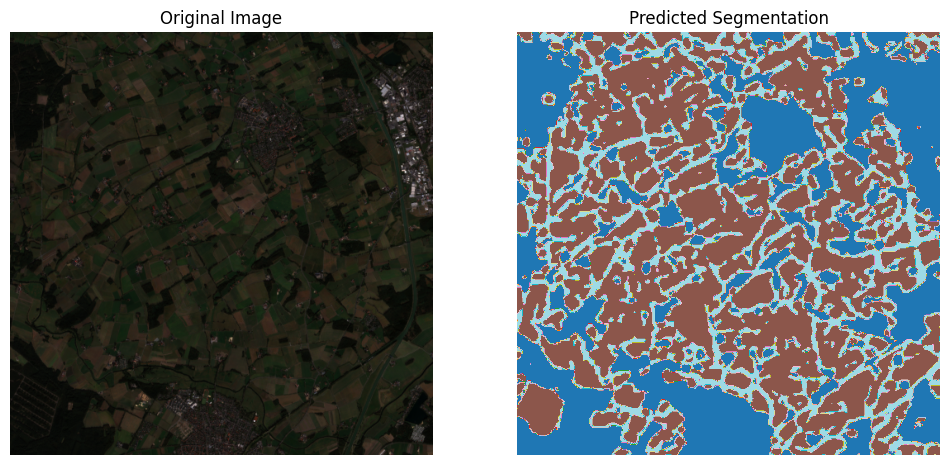

...

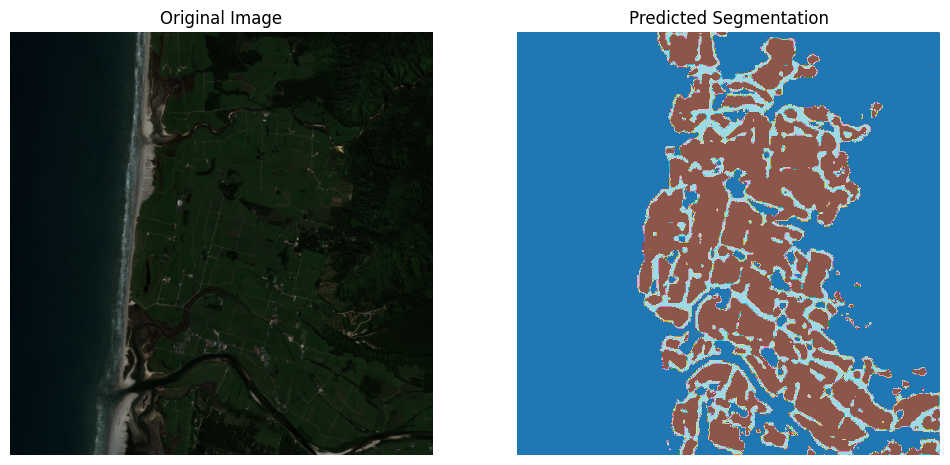

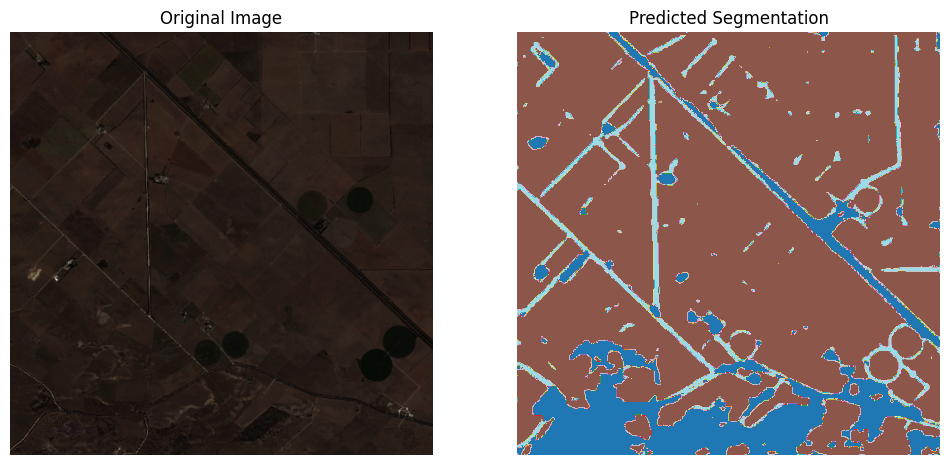

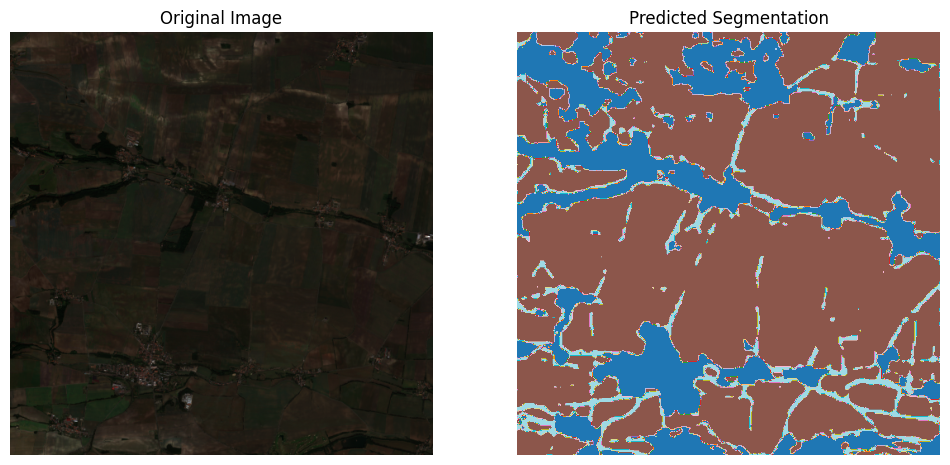

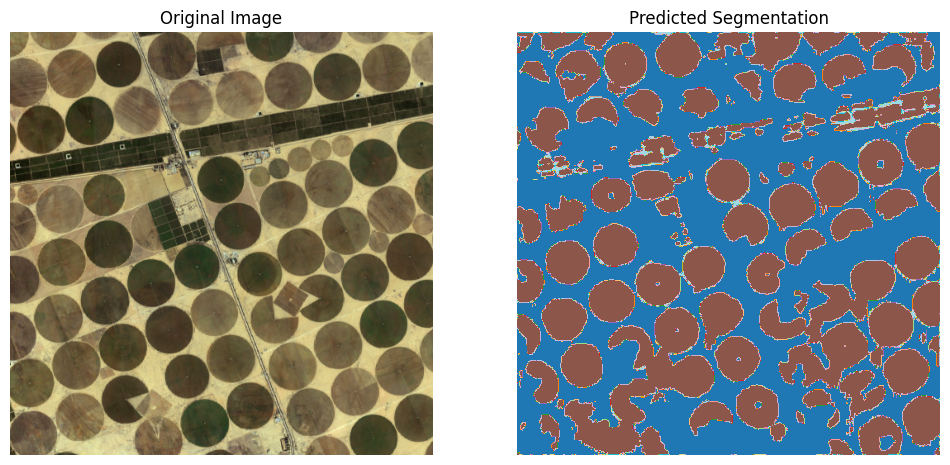

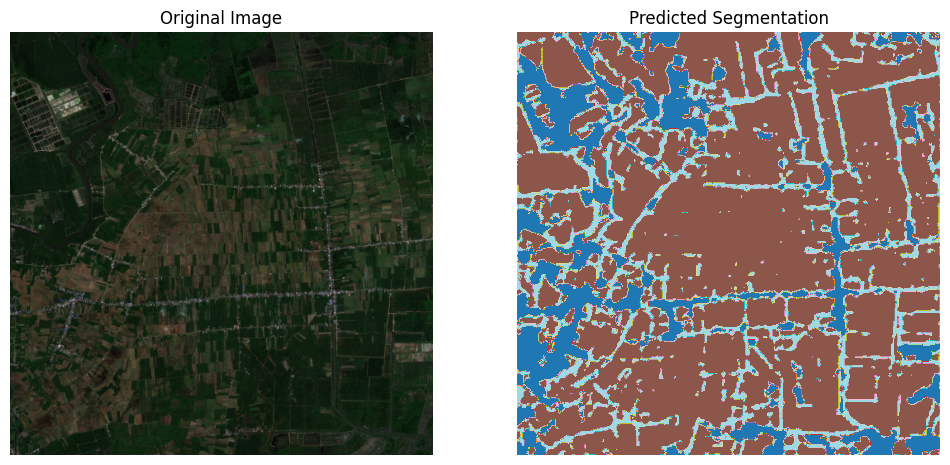

In [12]:
# Memuat model yang sudah disimpan
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_test = UNet(encoder_name="resnet50", in_channels=3, num_classes=3, pretrained=True).to(device)# Pastikan model sesuai dengan model yang sudah dilatih
model_test.load_state_dict(torch.load("best_model_2.pth"))
model_test.eval()  # Set model ke evaluasi mode

# 7. Fungsi untuk melakukan prediksi dan menampilkan gambar
import matplotlib.pyplot as plt

def display_predictions(model, dataloader, num_classes=3):
    """
    Fungsi untuk melakukan prediksi dan menampilkan gambar hasil segmentasi.
    """
    model.eval()  # Pastikan model dalam mode evaluasi
    with torch.no_grad():
        for images, filenames in dataloader:
            images = images.to(device)  # Memindahkan gambar ke perangkat (GPU/CPU)

            # Lakukan prediksi
            outputs = model(images)
            predictions = torch.argmax(outputs, dim=1).cpu().squeeze(0).numpy()  # Ambil kelas dengan probabilitas tertinggi

            # Ambil gambar asli untuk perbandingan
            original_image = images.cpu().squeeze(0).permute(1, 2, 0).numpy()  # Mengubah tensor kembali menjadi format gambar

            # Tampilkan gambar asli dan hasil prediksi
            plt.figure(figsize=(12, 6))

            plt.subplot(1, 2, 1)
            plt.title("Original Image")
            plt.imshow(original_image)
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.title("Predicted Segmentation")
            plt.imshow(predictions, cmap='tab20')  # Colormap untuk multi-kelas
            plt.axis('off')

            plt.show()

        # Hanya tampilkan satu gambar untuk demonstrasi

              # Hanya tampilkan satu gambar untuk demonstrasi


# Tampilkan hasil prediksi
display_predictions(model_test, test_loader)